<a href="https://colab.research.google.com/github/duybluemind1988/Data-science/blob/master/Analyze_bigdata2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!apt-get update
!apt-get install openjdk-8-jdk-headless -qq > /dev/null 
!wget -q https://downloads.apache.org/spark/spark-3.0.0/spark-3.0.0-bin-hadoop3.2.tgz
!tar -xvf spark-3.0.0-bin-hadoop3.2.tgz
!pip install -q findspark

In [ ]:
import pandas as pd
import numpy as np

import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.0.0-bin-hadoop3.2"

import numpy as np
import pandas as pd
import findspark
findspark.init()
from pyspark.sql import SparkSession

spark = SparkSession.builder.master("local[*]").getOrCreate()

In [ ]:
path='/content/drive/My Drive/Data/Sonion/V04R-V04R-SQLData.dat' # 2gb
df = spark.read.option("delimiter", "\t").csv(path)
df.show(5)

+--------+---+-------+---+-------+------------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+----+----+----+----+----+----+------+------+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+------+-------+----+------+-------+----+------+-------+----+------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+------+----+-------+-------+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+---------+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|     _c0|_c1|    _c2|_c3|    _c4|               _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|_c28|_c29|_

In [ ]:
df.groupBy('_c2').count().show()

+--------------+-------+
|           _c2|  count|
+--------------+-------+
|CP_SU3032_0112|  13088|
|CP_SU3037_0112|      1|
|     EST65DB01|      2|
|          5820|     75|
|          null|     89|
|  tSU3037_0112|     45|
|   su3032_0112|   1726|
|  su3037_0112t|      3|
|   SU3032_0112| 521965|
|  SU3037_0112t|    342|
|   SU3036_0110| 208614|
|   SU2010_0112|    305|
|       33ae015|     10|
|   SU3037_0112|2331513|
|   su3036_0110|    533|
|  t-su_ritep01|      1|
|          5070|      3|
|cp_su3032_0112|     50|
|       33AE015|      1|
|   su3037_0112|   7095|
+--------------+-------+



In [ ]:
product='CP_SU3032_0112'
df_product=df.filter(df._c2 == product)
df_product.show(5)

+-------+--------------------+--------------+----+-------+-----------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+------+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+-------+-------+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|    _c0|                 _c1|           _c2| _c3|    _c4|              _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|_c28|_c29|_c30|_c31|_c

In [ ]:
data_array=np.array(df_product.select('_c40').collect())
data_array

array([['119.46'],
       ['119.84'],
       ['119.38'],
       ...,
       ['118.73'],
       ['119.88'],
       ['120.09']], dtype='<U6')

In [ ]:
date_array=np.array(df_product.select('_c5').collect())
date_array

array([['1/16/2018 7:41:45'],
       ['1/16/2018 7:41:55'],
       ['1/16/2018 7:42:4'],
       ...,
       ['9/16/2019 8:3:25'],
       ['9/16/2019 8:3:30'],
       ['9/16/2019 8:3:36']], dtype='<U19')

In [ ]:
import plotly.graph_objs as go

In [ ]:
df_sub=pd.DataFrame(data_array)
df_sub.head()

,0
0,119.46
1,119.84
2,119.38
3,119.67
4,119.69


In [ ]:
import plotly.express as px
fig=px.histogram(df_sub,x=df_sub[0])
fig.show()

In [ ]:
fig = px.line(x=pd.DataFrame(date_array)[0], y=pd.DataFrame(data_array)[0])
fig.show()

# Combine to one

In [ ]:
import plotly.express as px

           _c2|  count|
+--------------+-------+
|CP_SU3032_0112|  13088|
|CP_SU3037_0112|      1|
|     EST65DB01|      2|
|          5820|     75|
|          null|     89|
|  tSU3037_0112|     45|
|   su3032_0112|   1726|
|  su3037_0112t|      3|
|   SU3032_0112| 521965|
|  SU3037_0112t|    342|
|   SU3036_0110| 208614|
|   SU2010_0112|    305|
|       33ae015|     10|
|   SU3037_0112|2331513|
|   su3036_0110|    533|
|  t-su_ritep01|      1|
|          5070|      3|
|cp_su3032_0112|     50|
|       33AE015|      1|
|   su3037_0112|   7095|
+--------------+-------+

In [ ]:
product='CP_SU3032_0112'
df_product=df.filter(df._c2 == product)
data_array=np.array(df_product.select('_c40').collect())
date_array=np.array(df_product.select('_c5').collect())

In [ ]:
len(data_array)

13088

In [ ]:
fig = px.line(x=pd.DataFrame(date_array)[0], y=pd.DataFrame(data_array)[0])
fig.show()

In [ ]:
fig=px.histogram(x=pd.DataFrame(data_array)[0])
fig.show()

In [ ]:
import plotly.graph_objects as go
#for i in range(len(data_array)):
fig = go.Figure()
for i in range(100):
  date_array_=date_array[i]
  data_array_=data_array[i]
  fig.add_trace(go.Scatter(x=pd.DataFrame(date_array_)[0], y=pd.DataFrame(data_array_)[0],
                    mode='markers',line=dict( color='#4280F5')
                    ))
fig.show()

# Final

## Prepare data

In [ ]:
import pandas as pd
import numpy as np

import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.0.0-bin-hadoop3.2"

import numpy as np
import pandas as pd
import datetime
from dateutil.parser import parse
import findspark
findspark.init()
from pyspark.sql import SparkSession

spark = SparkSession.builder.master("local[*]").getOrCreate()

In [ ]:
%%time
path='/content/drive/My Drive/Data/Sonion/V04R-V04R-SQLData.dat' # 1.88 gb
df = spark.read.option("delimiter", "\t").csv(path)
df.show(5)

+--------+---+-------+---+-------+------------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+----+----+----+----+----+----+------+------+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+------+-------+----+------+-------+----+------+-------+----+------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+------+----+-------+-------+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+---------+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|     _c0|_c1|    _c2|_c3|    _c4|               _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|_c28|_c29|_

In [ ]:
%%time
print((df.count(), len(df.columns)))

(3085461, 136)
CPU times: user 61.9 ms, sys: 4.21 ms, total: 66.1 ms
Wall time: 10.7 s


In [ ]:
%%time
product_type='_c2'
df.groupBy(product_type).count().show()
# Take 39s to analyze one column

+--------------+-------+
|           _c2|  count|
+--------------+-------+
|CP_SU3032_0112|  13088|
|CP_SU3037_0112|      1|
|     EST65DB01|      2|
|          5820|     75|
|          null|     89|
|  tSU3037_0112|     45|
|   su3032_0112|   1726|
|  su3037_0112t|      3|
|   SU3032_0112| 521965|
|  SU3037_0112t|    342|
|   SU3036_0110| 208614|
|   SU2010_0112|    305|
|       33ae015|     10|
|   SU3037_0112|2331513|
|   su3036_0110|    533|
|  t-su_ritep01|      1|
|          5070|      3|
|cp_su3032_0112|     50|
|       33AE015|      1|
|   su3037_0112|   7095|
+--------------+-------+

CPU times: user 7.04 ms, sys: 678 µs, total: 7.72 ms
Wall time: 24.1 s


In [ ]:
%%time
product='SU3037_0112' #CP_SU3032_0112 : just 13088 row
df_product=df.filter(df._c2 == product)
df_product.show(5) 
# Take 14 min for filter one item config (~ 2tr3 rows)

+-------+--------------------+-----------+----+-------+-----------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+----+----+----+----+----+----+-----+------+------+------+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+------+-------+----+------+-------+----+-------+-------+----+-------+-------+----+-------+------+----+-------+-------+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|    _c0|                 _c1|        _c2| _c3|    _c4|              _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|

In [ ]:
%%time
df_product.describe().show() # take 8 min for 2331506 row and 136 column analyze

+-------+-------+------------------+-----------+-----------------+--------------------+----------------+--------------------+-------+-------+------------------+-------+-------+-----------------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-----------------+-------+-------+-------+-------+-------+-------+-------+------------------+------------------+------------------+------------------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+---

In [ ]:
%%time
print((df_product.count(), len(df_product.columns)))

(2331513, 136)
CPU times: user 4.71 ms, sys: 1.63 ms, total: 6.34 ms
Wall time: 20.6 s


In [ ]:
%%time
value_column='_c40'
time_column='_c5'

df_product_select=df_product.select(time_column,value_column).collect()

CPU times: user 9.88 s, sys: 1.07 s, total: 10.9 s
Wall time: 35.8 s


In [ ]:
print(len(df_product_select))
df_product_select[:3]

2331513


[Row(_c5='1/12/2018 14:6:39', _c40='115.16'),
 Row(_c5='1/12/2018 14:6:53', _c40='114.93'),
 Row(_c5='1/12/2018 14:7:1', _c40='115.06')]

In [ ]:
%%time
df_product_new=pd.DataFrame(df_product_select,columns=['Date','Value']).reset_index(drop=True)
df_product_new.head()

CPU times: user 760 ms, sys: 135 ms, total: 894 ms
Wall time: 897 ms


In [ ]:
%%time
df_product_new['Date_new']=df_product_new['Date'].apply(lambda x: parse(x) )
df_product_new['Date_new']=df_product_new['Date_new'].apply(lambda x: x.date() )

CPU times: user 2min 43s, sys: 910 ms, total: 2min 44s
Wall time: 2min 45s


In [ ]:
df_product_new.head()

,Date,Value,Date_new
0,1/12/2018 14:6:39,115.16,2018-01-12
1,1/12/2018 14:6:53,114.93,2018-01-12
2,1/12/2018 14:7:1,115.06,2018-01-12
3,1/12/2018 14:7:18,115.22,2018-01-12
4,1/12/2018 14:7:22,114.96,2018-01-12


In [ ]:
%%time
df_product_new['Value']=df_product_new['Value'].astype('float')

CPU times: user 264 ms, sys: 970 µs, total: 265 ms
Wall time: 268 ms


## Box plot chart

Khong vẽ được do tràn bộ nhớ, tìm phương án khác vẽ box plot

In [ ]:
#fig = go.Figure()
#fig.add_trace(go.Box(x=df_product_new.Date_new, y=df_product_new.Value,line=dict(color='#4280F5')))
#ig.show()


## Line chart

In [ ]:
%%time
df_product_new_agg=df_product_new.groupby(['Date_new']).agg({'Value':['mean','std']})
df_product_new_agg.head()

CPU times: user 441 ms, sys: 3.99 ms, total: 445 ms
Wall time: 451 ms


In [ ]:
df_product_new_agg.columns

MultiIndex([('Value', 'mean'),
            ('Value',  'std')],
           )

In [ ]:
%%time
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(rows=2,cols=1,
    subplot_titles=(['mean','std']))

# Add traces
fig.add_trace(
    go.Scatter(x=df_product_new_agg.index, y=df_product_new_agg['Value','mean'],
               name="Mean",line=dict( color='#FF5733'),mode='lines+markers'),
   row=1,col=1
)

fig.add_trace(
    go.Scatter(x=df_product_new_agg.index, y=df_product_new_agg['Value','std'],
               name="Std",line=dict( color='#4280F5'),mode='lines+markers'),
    row=2,col=1
)


fig.show()

CPU times: user 792 ms, sys: 182 ms, total: 974 ms
Wall time: 992 ms


## Add UCL, LCL, MEAN

In [ ]:
%%time
sigma=3
temp=df_product_new_agg['Value','mean']
temp_std=df_product_new_agg['Value','std']
df_final = df_product_new_agg.assign(
              UCL=temp.mean() + temp.std()*sigma,
              LCL=temp.mean() - temp.std()*sigma,
              mean=temp.mean(),
              UCL_std=temp_std.mean() + temp_std.std()*sigma
              )
df_final.head()

CPU times: user 9.15 ms, sys: 0 ns, total: 9.15 ms
Wall time: 9.58 ms


In [ ]:
df_final.columns

MultiIndex([(  'Value', 'mean'),
            (  'Value',  'std'),
            (    'UCL',     ''),
            (    'LCL',     ''),
            (   'mean',     ''),
            ('UCL_std',     '')],
           )

In [ ]:
%%time
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(rows=2,cols=1,
    subplot_titles=(['mean','std']))

# Add traces
fig.add_trace(
    go.Scatter(x=df_final.index, y=df_final['Value','mean'],
               name="Mean",line=dict( color='#FF5733'),mode='lines+markers'),
   row=1,col=1
)

fig.append_trace(go.Scatter(x=df_final.index, y=df_final['UCL',''],name='UCL ',
                            line=dict( color='#33C2FF')),row=1, col=1)
fig.append_trace(go.Scatter(x=df_final.index, y=df_final['LCL',''],name='LCL ', 
                            line=dict( color='#33C2FF')),row=1, col=1)
fig.append_trace(go.Scatter(x=df_final.index, y=df_final['mean',''],name='mean ', 
                            line=dict( color='#33C2FF')),row=1, col=1)


fig.add_trace(
    go.Scatter(x=df_final.index, y=df_final['Value','std'],
               name="Std",line=dict( color='#4280F5'),mode='lines+markers'),
    row=2,col=1
)
fig.append_trace(go.Scatter(x=df_final.index, y=df_final['UCL_std',''],name='UCL_std ', 
                            line=dict( color='#33C2FF')),row=2, col=1)


fig.show()

CPU times: user 337 ms, sys: 8 ms, total: 345 ms
Wall time: 354 ms


## Box chart

In [ ]:
df_product_new

,Date,Value,Date_new
0,1/12/2018 14:6:39,115.16,2018-01-12
1,1/12/2018 14:6:53,114.93,2018-01-12
2,1/12/2018 14:7:1,115.06,2018-01-12
3,1/12/2018 14:7:18,115.22,2018-01-12
4,1/12/2018 14:7:22,114.96,2018-01-12
...,...,...,...
2331508,9/20/2019 18:51:52,116.28,2019-09-20
2331509,9/20/2019 18:51:58,115.90,2019-09-20
2331510,9/20/2019 18:52:4,116.63,2019-09-20
2331511,9/20/2019 18:52:11,116.17,2019-09-20


In [ ]:
date_list=df_product_new['Date_new'].unique().tolist()
print(len(date_list))

596


In [ ]:
date_list[0]

datetime.date(2018, 1, 12)

In [ ]:
df_product_new.loc[df_product_new.Date_new==date_list[2]]

,Date,Value,Date_new
7420,1/14/2018 0:0:0,116.04,2018-01-14
7421,1/14/2018 0:0:7,116.34,2018-01-14
7422,1/14/2018 0:0:13,115.51,2018-01-14
7423,1/14/2018 0:0:19,116.39,2018-01-14
7424,1/14/2018 0:0:26,115.67,2018-01-14
...,...,...,...
10404,1/14/2018 13:23:17,115.46,2018-01-14
10405,1/14/2018 13:23:23,115.44,2018-01-14
10406,1/14/2018 13:23:30,115.48,2018-01-14
10407,1/14/2018 13:23:37,115.62,2018-01-14


In [ ]:
range(1,3)

range(1, 3)

In [ ]:
#import plotly.graph_objects as go
#fig = go.Figure()
#for i in range(1,len(date_list)):
#  df_temp=df_product_new.loc[df_product_new.Date_new==date_list[i]]
#  fig.add_trace(go.Box(
#                          x=df_temp.Date_new, y=df_temp.Value,
#                          name='mean ', line=dict( color='#4280F5')
#                          )
#                )
#  if i%100 ==0: 
#    fig.show()
#    fig = go.Figure()

#fig.show()

## Histogram

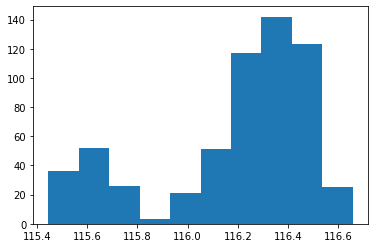

In [ ]:
import matplotlib.pyplot as plt
plt.hist(df_final['Value','mean'])
plt.show()

# Handy spark

In [ ]:
from handyspark import *

ModuleNotFoundError: ignored

In [ ]:
hdf = df_product.toHandy()

In [ ]:
value_column='_c40'
time_column='_c5'
hdf_select=hdf.cols[[time_column,value_column]]
hdf_select[:5]

In [ ]:
hdf.cols['_c40'].hist()